# Import the packages

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Problem Statement :
Data set have 12 Plant Species

In [ ]:
!pip install -q keras

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator,load_img,img_to_array
from tensorflow.keras.layers import Flatten, Dense,Dropout,BatchNormalization,MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tkinter import ttk ## This is fancy version of tkinter
from sklearn.model_selection import train_test_split
from tensorflow.keras import regularizers, optimizers
from sklearn.model_selection import RandomizedSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier



from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import RandomForestClassifier
from tensorflow.keras.layers import Conv2D
from keras.models import model_from_json
import tkinter as tk
import h5py

import matplotlib.pyplot as plt
import tensorflow as tf
from sklearn import svm
import skimage.io as io


import numpy as np
%matplotlib inline
import keras
import cv2
import os


from tensorflow.keras.callbacks import ReduceLROnPlateau
from scipy.stats import randint as sp_randint
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import learning_curve
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from keras.callbacks import EarlyStopping
from sklearn.pipeline import make_pipeline




# Set Paths to Local Variables

In [ ]:
train_path="/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train"
test_path="/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/test"
Homepath="/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input"

#Load image and Visualize the data + Dimensions


In [ ]:
!ls

drive  sample_data


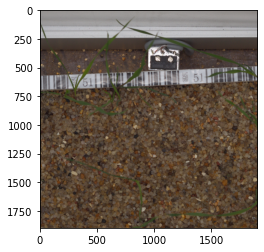

In [ ]:
# img=image.load_img("/content/drive/MyDrive/AIML/Computer Vision/Part_1_Input/train/Black-grass/0ace21089.png")
img = io.imread("/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Black-grass/0ace21089.png")

plt.imshow(img)
plt.show()


In [ ]:
img.shape

(1899, 1900, 3)

In [ ]:


train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)


In [ ]:
# Setting training data generator's source directory
# Setting the target size to resize all the images to (64,64) as the model input layer expects 32X32 images

training_set = train_datagen.flow_from_directory(train_path,
                                                 target_size = (64, 64),
                                                 batch_size = 32,
                                                 class_mode = 'categorical')



Found 4767 images belonging to 12 classes.


There are 4767 training images in total . Distributed  towards the 12 classes 

In [ ]:
training_set.class_indices

{'Black-grass': 0,
 'Charlock': 1,
 'Cleavers': 2,
 'Common Chickweed': 3,
 'Common wheat': 4,
 'Fat Hen': 5,
 'Loose Silky-bent': 6,
 'Maize': 7,
 'Scentless Mayweed': 8,
 'Shepherds Purse': 9,
 'Small-flowered Cranesbill': 10,
 'Sugar beet': 11}

In [ ]:
training_set.classes

array([ 0,  0,  0, ..., 11, 11, 11], dtype=int32)

# **Train tune and test AIML image classifier**

Train tune and test AIML image classifier model using:
1.   Use supervised learning algorithms for training
2.   Use neural networks for training
3.  Use CNN for training


In [ ]:
for dirname, _, filenames in os.walk('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train'):
    for filename in filenames:
        os.path.join(dirname, filename)


In [ ]:
# Creating Training Dataset
training_data=[]
Folders=['Black-grass','Charlock','Cleavers','Common Chickweed','Common wheat','Fat Hen','Loose Silky-bent','Maize','Scentless Mayweed','Shepherds Purse','Small-flowered Cranesbill','Sugar beet']

In [ ]:
for category in Folders:
  print(category)
  path=os.path.join(train_path, category)
  print(path)
  class_num=Folders.index(category)
  print(class_num)
  for image in os.listdir(path):
    img_array=cv2.imread(os.path.join(path,image))
    new_array=cv2.resize(img_array,(64,64))
    training_data.append([new_array,class_num])

Black-grass
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Black-grass
0
Charlock
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Charlock
1
Cleavers
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Cleavers
2
Common Chickweed
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Common Chickweed
3
Common wheat
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Common wheat
4
Fat Hen
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Fat Hen
5
Loose Silky-bent
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Loose Silky-bent
6
Maize
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize
7
Scentless Mayweed
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Scentless Mayweed
8
Shepherds Purse
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Shepherds Purse
9
Small-flowered Cranesbill
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Small-flowered Cranesb

In [ ]:
#Dividing into training and testing set
X=[]
y=[]

for categories, label in training_data:
    X.append(categories)
    y.append(label)

In [ ]:
X=np.array(X)
Y=np.array(y)

print("X Array shape:",X.shape)
print("Y array Shape:",Y.shape)

print(Y[0])

X Array shape: (4767, 64, 64, 3)
Y array Shape: (4767,)
0


Label: 0


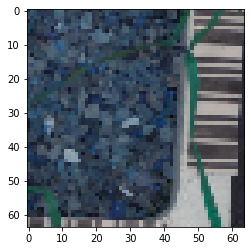

In [ ]:
print("Label: {}".format(Y[8]))
plt.imshow(X[8], cmap='gray')

## Supervised Learning



*   Decision Tree
*   Random Forest



#### Decision Tree

In [ ]:
# Reshape and normalize the data useful for Supervised Learning and Neural Networks - 64*64*3= 12288
print("Before Train Set:",X.shape)
x_SVM = X.reshape(4767, 12288)
print("After Train Set:",x_SVM.shape)

Before Train Set: (4767, 64, 64, 3)
After Train Set: (4767, 12288)


In [ ]:
#Normalize the dataset
x_SVM = x_SVM / 255.0

In [ ]:
print("Before :",X[0])
print('***********************')
print("After :",x_SVM[0])

Before : [[[ 24  46  78]
  [ 37  58  81]
  [ 73  92 110]
  ...
  [ 80  91 102]
  [ 54  73  85]
  [ 59  82  91]]

 [[ 28  51  83]
  [ 39  59  85]
  [ 29  49  73]
  ...
  [ 61  75  88]
  [ 58  71  83]
  [ 58  73  85]]

 [[ 34  59  87]
  [ 27  49  76]
  [ 29  51  74]
  ...
  [ 66  77  93]
  [ 59  69  84]
  [ 48  64  77]]

 ...

 [[156 149 143]
  [151 144 140]
  [ 82  76  78]
  ...
  [157 150 145]
  [148 141 138]
  [ 72  63  73]]

 [[156 150 144]
  [150 144 139]
  [ 81  74  77]
  ...
  [160 152 147]
  [150 143 139]
  [ 73  67  72]]

 [[156 150 143]
  [148 143 137]
  [ 79  74  76]
  ...
  [158 149 142]
  [150 142 138]
  [ 72  66  70]]]
***********************
After : [0.09411765 0.18039216 0.30588235 ... 0.28235294 0.25882353 0.2745098 ]


In [ ]:
#Split data into train and validation
X_train_SVM, X_val_SVM, y_train_SVM, y_val_SVM = train_test_split(x_SVM,Y,test_size=0.3)

Decision Tree - without Randomized Search Technique

In [ ]:

dTree = DecisionTreeClassifier(criterion = 'entropy',random_state = 100,max_depth=30)

In [ ]:
dTree.fit(X_train_SVM, y_train_SVM)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=30, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=100, splitter='best')

In [ ]:
print(dTree.score(X_train_SVM, y_train_SVM))
print(dTree.score(X_val_SVM, y_val_SVM))

1.0
0.28791055206149546


Decision Tree with randomized Search - **Fine Tuning**

In [ ]:
# specify parameters and distributions to sample from
param_dist = {"max_depth": [3, 20],
              "max_features": sp_randint(1, 20),
              "min_samples_split": sp_randint(2, 20),
              "min_samples_leaf": sp_randint(1, 20),
              "random_state" :[1,100],
              "splitter":["best", "random"],
              "criterion": ["gini", "entropy"]}

In [ ]:
samples = 30  # number of random samples 
dTree_finetune = RandomizedSearchCV(dTree, param_distributions=param_dist, n_iter=samples) #default cv = 3

In [ ]:
dTree_finetune.fit(X_train_SVM, y_train_SVM)

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=DecisionTreeClassifier(ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='entropy',
                                                    max_depth=30,
                                                    max_features=None,
                                                    max_leaf_nodes=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
                                                    presort='deprecated',
                                                    random_state=100,
       

In [ ]:
print(dTree_finetune.best_params_)

{'criterion': 'entropy', 'max_depth': 20, 'max_features': 13, 'min_samples_leaf': 18, 'min_samples_split': 6, 'random_state': 100, 'splitter': 'best'}


In [ ]:
print(dTree_finetune.score(X_train_SVM, y_train_SVM))
print(dTree_finetune.score(X_val_SVM, y_val_SVM))

0.37859712230215825
0.22431865828092243


We can see that there is slight reduction in the accuracy gap between training and validation dataset (i.ee We can see difference with n without using Randamized Search)

#### Random Forest

In [ ]:
# build a classifier
randomforest = RandomForestClassifier(n_estimators=50)

In [ ]:
# use a full grid over all parameters
param_grid_rand = {"max_depth": [3, None],
              "max_features": [1,  20],
              "min_samples_split": [2,  20],
              "min_samples_leaf": [1,  20],
              "bootstrap": [True, False],
              "criterion": ["gini", "entropy"]}

In [ ]:
random_forest_tune = RandomizedSearchCV(randomforest, param_distributions=param_grid_rand, n_iter=10)
random_forest_tune.fit(X_train_SVM, y_train_SVM)

RandomizedSearchCV(cv=None, error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_split=2,
                                                    min_weight_fraction_leaf=0.0,
            

In [ ]:
print(random_forest_tune.score(X_train_SVM, y_train_SVM))
print(random_forest_tune.score(X_val_SVM, y_val_SVM))

0.8126498800959233
0.47938504542278126


## Neural Network    

**Using Neural Network**

Here we are following the below flow


* Input Size = (64,64,3) -  Resize the above input into 64X64X3
* No of Outputs : 12

Neural Network Architecture :


1.   1st Layer --> Flatten
2.   2nd Layer --> Batch Normalization
3.   3rd Layer --> 68 Neurons Dense Layer - Activation Function "Relu"
4.   Drop out
5. Output Layer --> 12 neurons
6.   Softmax --> Softmax




In [ ]:
X=np.array(X)
Y=np.array(y)

print("X Array shape:",X.shape)
print("Y array Shape:",Y.shape)

X Array shape: (4767, 64, 64, 3)
Y array Shape: (4767,)


In [ ]:
# Reshape and normalize the data useful for Supervised Learning and Neural Networks - 64*64*3= 12288
print("Before Train Set:",X.shape)
x_NN = X.reshape(4767, 12288)
print("After Train Set:",x_NN.shape)

Before Train Set: (4767, 64, 64, 3)
After Train Set: (4767, 12288)


In [ ]:
#Normalize the Training Set
x_NN = x_NN.astype('float32')

x_NN /= 255
print(x_NN.shape)
print(Y.shape)

(4767, 12288)
(4767,)


In [ ]:
#Split data into train and validation
X_train_NNet, X_val_NNet, y_train_NNet, y_val_NNet = train_test_split(x_NN,Y,test_size=0.3)

In [ ]:

print(X_train_NNet.shape)
print(y_train_NNet.shape)


print(X_val_NNet.shape)
print(y_val_NNet.shape)

(3336, 12288)
(3336,)
(1431, 12288)
(1431,)


In [ ]:
# Do onehot encoding to convert Y train - Here Converting into 12
y_train_NNet = to_categorical(y_train_NNet, num_classes=12)
y_val_NNet = to_categorical(y_val_NNet, num_classes=12)
print('Before::',Y.shape)
print('After : ', y_train_NNet.shape)
print('After : ', y_val_NNet.shape)

Before:: (4767,)
After :  (3336, 12)
After :  (1431, 12)


In [ ]:
print('Before::',Y.shape)
print('After : ', y_train_NNet.shape)
print('After : ', y_val_NNet.shape)

Before:: (4767,)
After :  (3336, 12)
After :  (1431, 12)


In [ ]:
NN_model = Sequential()
NN_model.add(Flatten())
NN_model.add(BatchNormalization())
NN_model.add(Dense(68, activation="relu"))
NN_model.add(Dropout(0.6))
NN_model.add(Dense(12, activation="softmax"))

In [ ]:
NN_model.summary

<bound method Model.summary of <tensorflow.python.keras.engine.sequential.Sequential object at 0x7fc7476340d0>>

In [ ]:
learning_rate=0.01
sgd = optimizers.Adam(lr=learning_rate)

In [ ]:
# Compile the model
NN_model.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer="sgd")


In [ ]:
#Early Stopping
earlystop = EarlyStopping(monitor = 'accuracy',min_delta = 0.001,patience = 5, verbose = 1,restore_best_weights = True)

In [ ]:

# Fit the model
history= NN_model.fit(x=X_train_NNet, y=y_train_NNet, batch_size=1000, epochs=200, validation_data=(X_val_NNet, y_val_NNet),callbacks=earlystop)

Epoch 1/200
4/4 [==============================] - 3s 429ms/step - loss: 3.5686 - accuracy: 0.0953 - val_loss: 2.4471 - val_accuracy: 0.1391
Epoch 2/200
4/4 [==============================] - 1s 234ms/step - loss: 3.1169 - accuracy: 0.1380 - val_loss: 2.4419 - val_accuracy: 0.1747
Epoch 3/200
4/4 [==============================] - 1s 217ms/step - loss: 2.8900 - accuracy: 0.1577 - val_loss: 2.4402 - val_accuracy: 0.1523
Epoch 4/200
4/4 [==============================] - 1s 215ms/step - loss: 2.6189 - accuracy: 0.2180 - val_loss: 2.4344 - val_accuracy: 0.1565
Epoch 5/200
4/4 [==============================] - 1s 224ms/step - loss: 2.4911 - accuracy: 0.2332 - val_loss: 2.4321 - val_accuracy: 0.1363
Epoch 6/200
4/4 [==============================] - 1s 207ms/step - loss: 2.4339 - accuracy: 0.2471 - val_loss: 2.4101 - val_accuracy: 0.1600
Epoch 7/200
4/4 [==============================] - 1s 224ms/step - loss: 2.3210 - accuracy: 0.2764 - val_loss: 2.4076 - val_accuracy: 0.1803
Epoch 8/200
4

In [ ]:
train_scores=NN_model.evaluate(X_train_NNet, y_train_NNet)

105/105 [==============================] - 0s 4ms/step - loss: 1.0606 - accuracy: 0.9302


In [ ]:
val_scores=NN_model.evaluate(X_val_NNet, y_val_NNet)

45/45 [==============================] - 0s 4ms/step - loss: 1.7598 - accuracy: 0.4570


In [ ]:
train_scores

[1.0605943202972412, 0.930155873298645]

Loss and Accuracy Charts

(0.1, 1.0)

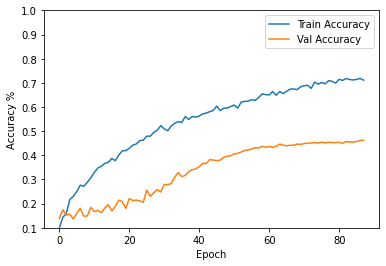

In [ ]:

plt.figure()
plt.xlabel('Epoch')
plt.ylabel('Accuracy %')
plt.plot(history.epoch, np.array(history.history['accuracy']),
label='Train Accuracy')
plt.plot(history.epoch, np.array(history.history['val_accuracy']),
label = 'Val Accuracy')
plt.legend()
plt.ylim([0.1, 1])

## CNN Architecture

**CNN**

CNN Architecture:

Input : 3 Channels - 64X64

CONV2D Layer - 32 3X3 Filters ----- MAX Pooling ----- CONV2D Layer - 64 3X3 Filters ----- MAX Pooling ------ CONV2D Layer -128 3X3 Filters ----- MAX Pooling ----- FC (As mentioned in above NN)






In [ ]:
X=np.array(X)
Y=np.array(y)

print("X Array shape:",X.shape)
print("Y array Shape:",Y.shape)



X Array shape: (4767, 64, 64, 3)
Y array Shape: (4767,)


In [ ]:
#Normalize the Training Set
x_CNN = X.astype('float32')

x_CNN /= 255
print(x_CNN.shape)
print(Y.shape)

(4767, 64, 64, 3)
(4767,)


In [ ]:
# Do onehot encoding to convert Y train - Here Converting into 12
y_CNN = to_categorical(Y, num_classes=12)

print('Before::',Y.shape)
print('After : ', y_CNN.shape)


Before:: (4767,)
After :  (4767, 12)


In [ ]:
#Split data into train and validation
X_train_CNN, X_val_CNN, y_train_CNN, y_val_CNN = train_test_split(x_CNN,y_CNN,test_size=0.3)

In [ ]:
print("X_train shape:", X_train_CNN.shape)
print("X_train shape:", X_val_CNN.shape)
print("Images in X_train:", X_train_CNN.shape[0])
print("Images in X_test:", X_val_CNN.shape[0])
print("Max value in X_train:", X_train_CNN.max())
print("Min value in X_train:", X_val_CNN.min())

X_train shape: (3336, 64, 64, 3)
X_train shape: (1431, 64, 64, 3)
Images in X_train: 3336
Images in X_test: 1431
Max value in X_train: 1.0
Min value in X_train: 0.0


In [ ]:
model_CNN = Sequential()

model_CNN.add(Conv2D(filters=32, kernel_size=3, activation="relu", input_shape=(64, 64, 3)))
model_CNN.add(MaxPooling2D(pool_size=(2,2)))

model_CNN.add(Dropout(0.2))

model_CNN.add(Conv2D(filters=64, kernel_size=3, activation="relu"))
model_CNN.add(MaxPooling2D(pool_size=(2,2)))

model_CNN.add(Dropout(0.2))

model_CNN.add(Conv2D(filters=128, kernel_size=3, activation="relu"))
model_CNN.add(MaxPooling2D(pool_size=(2,2)))


model_CNN.add(Flatten())
model_CNN.add(Dense(68, activation="relu"))
model_CNN.add(Dropout(0.2))
model_CNN.add(Dense(12, activation="softmax"))

In [ ]:
learning_rate=0.01
sgd = optimizers.Adam(lr=learning_rate)

In [ ]:
# Compile the model
model_CNN.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer=sgd)



In [ ]:
#Early Stopping
callback = EarlyStopping(monitor = 'accuracy',min_delta = 0.001,patience = 5, verbose = 1,restore_best_weights = True)

# callback= ReduceLROnPlateau(monitor='accuracy',factor=0.1,patience=10,verbose=0,min_delta=0.002,cooldown=0,min_lr=0)

In [ ]:

# Fit the model
CNN_history= model_CNN.fit(x=X_train_CNN, y=y_train_CNN, batch_size=1000, epochs=200, validation_data=(X_val_CNN, y_val_CNN),callbacks=callback)

Epoch 1/200


(0.1, 1.0)

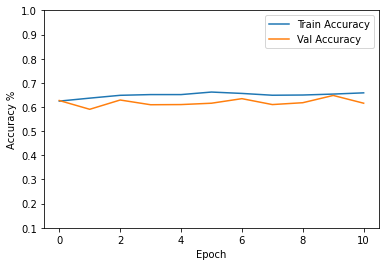

In [ ]:
plt.figure()
plt.xlabel('Epoch')
plt.ylabel('Accuracy %')
plt.plot(CNN_history.epoch, np.array(CNN_history.history['accuracy']),
label='Train Accuracy')
plt.plot(CNN_history.epoch, np.array(CNN_history.history['val_accuracy']),
label = 'Val Accuracy')
plt.legend()
plt.ylim([0.1, 1])

In [ ]:
train_scores=model_CNN.evaluate(X_train_CNN, y_train_CNN)

105/105 [==============================] - 6s 56ms/step - loss: 0.7757 - accuracy: 0.7173


In [ ]:
val_scores=model_CNN.evaluate(X_val_CNN, y_val_CNN)

45/45 [==============================] - 3s 56ms/step - loss: 1.1819 - accuracy: 0.6157


# Observation From all the above Models:


1.   In Supervised Learning Random Forest Performs better than DEcision Tree -  where in Decision Tree fine tuning improves in reducing the noise

2.   As Compared to all models CNN performs better with accuracy 70-80%. Even there is 10% gap between the training and validation accuracy 




# Pickle the Model

In [ ]:
os.chdir(Homepath)

In [ ]:
model_json = model_CNN.to_json()
with open("ComputerVision_Part1.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
model_CNN.save_weights("ComputerVision_Part1.h5")
print("Saved model to disk")

Saved model to disk


# Load the model and predict the image

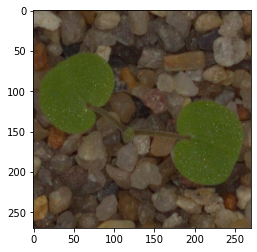

In [ ]:
# Read images from test data and check whether our model is predicting correctly or not

test_img= load_img('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/test/0021e90e4.png')
plt.imshow(test_img, cmap='gray')

In [ ]:
x1=img_to_array(test_img)
x1.shape
x1=cv2.resize(x1,(64,64))
x1.shape


(64, 64, 3)

In [ ]:
x1=x1.reshape((1,)+x1.shape) #  Reshaping the image in 4 D array (i.ee 3 channel)

print(x1.shape) 

(1, 64, 64, 3)


In [ ]:
x1=x1/255

In [ ]:
#print("Preiction for above image: ", np.argmax(model_CNN.predict(x1)))
print(x1.shape)
print("Prediction label for above image: ", np.argmax(model_CNN.predict(x1)))


(1, 64, 64, 3)
Prediction label for above image:  10


Images present in Label 10


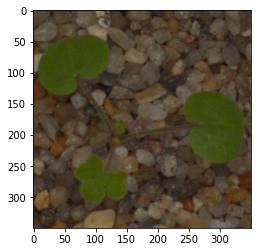

In [ ]:
print('Images present in Label 10')
true_img= load_img('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Small-flowered Cranesbill/003402ea0.png')
plt.imshow(true_img, cmap='gray')

The Predicted  Label is correct as label 10 is Small-flowered Cranesbill

Please refer predictimage.ipynb to Please refer  from GUI Foldder as below code is appended in the GUI Program to check it from UI

In [ ]:
# Open the file as readonly
# load json and create model
json_file = open('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/ComputerVision_Part1.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = model_from_json(loaded_model_json)
loaded_model.load_weights("/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/ComputerVision_Part1.h5")
print("Loaded model from disk")


Loaded model from disk


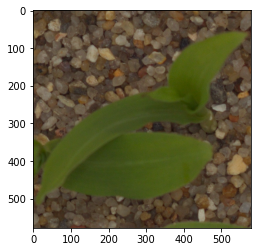

In [ ]:
predict_img= load_img(Homepath+'/Seedling - Prediction/Predict.png')
plt.imshow(predict_img, cmap='gray')

In [ ]:
x2=img_to_array(predict_img)
x2.shape
x2=cv2.resize(x2,(64,64))
x2.shape

(64, 64, 3)

In [ ]:
x2=x2.reshape((1,)+x2.shape) #  Reshaping the image in 4 D array (i.ee 3 channel)

print(x2.shape) 

(1, 64, 64, 3)


In [ ]:
x2=x2/255

In [ ]:
print(x2.shape)
print("Prediction label for above image: ", np.argmax(loaded_model.predict(x2)))


(1, 64, 64, 3)
Prediction label for above image:  7


Printing Images in Label 7 is maize


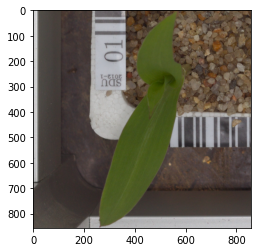

In [ ]:
print('Printing Images in Label 7 is maize')
test_img= load_img('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/006196e1c.png')
plt.imshow(test_img, cmap='gray')

Printing all images in Maize Folder
/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0086c28b2.png


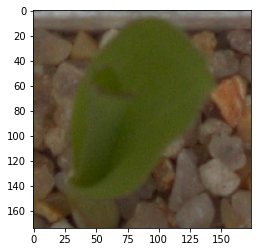

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/00a18f05e.png


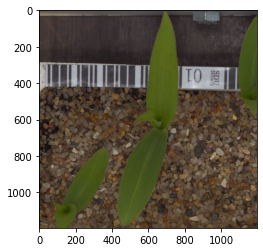

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/006196e1c.png


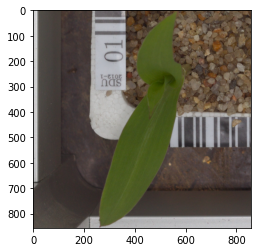

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0bdaf1d8f.png


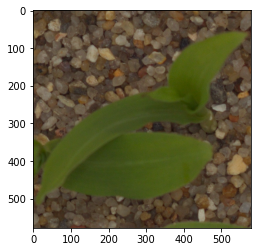

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0cd0d9b8c.png


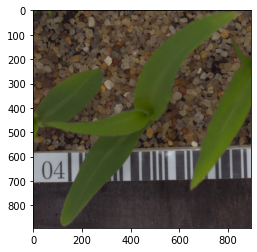

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/051ea51d0.png


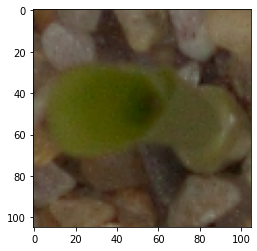

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/19f880311.png


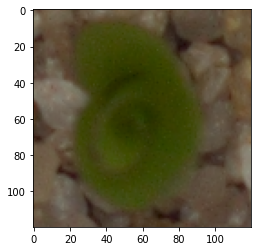

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0419f5bbc.png


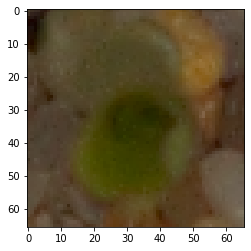

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/194d34152.png


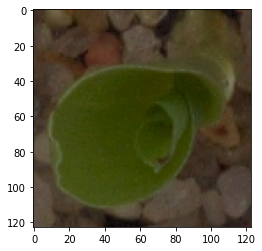

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/18b6755a1.png


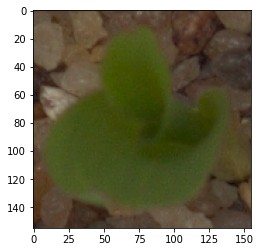

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/01642cae8.png


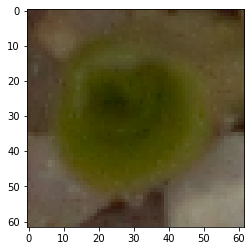

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/115808876.png


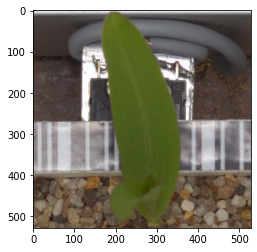

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/12025fcc1.png


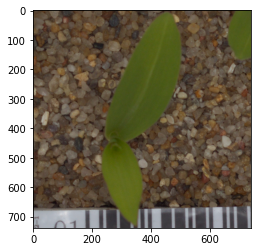

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/16511dd22.png


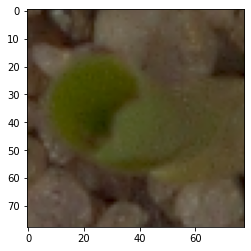

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0f16cf10a.png


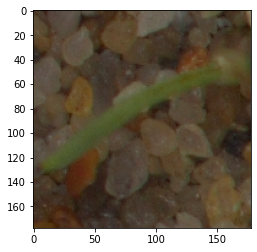

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/1d21b25f9.png


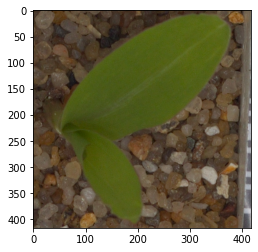

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/11dc03905.png


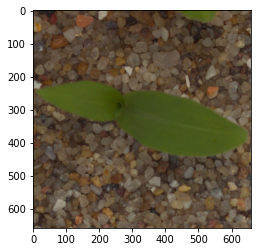

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/1898398b8.png


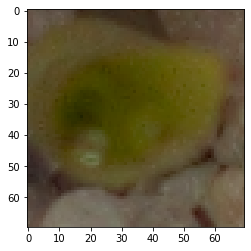

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/107bd7230.png


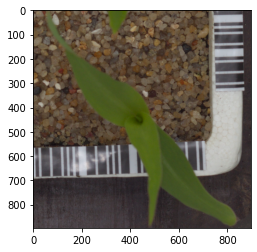

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/16e38d4af.png


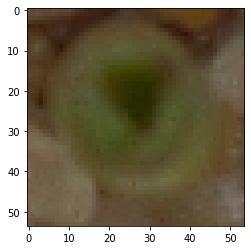

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/06e1ee6e1.png


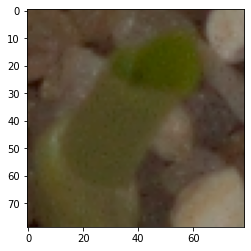

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0184ec53f.png


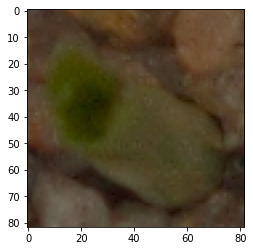

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/11323514a.png


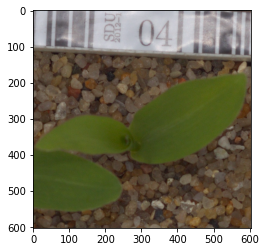

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/0150b5b7e.png


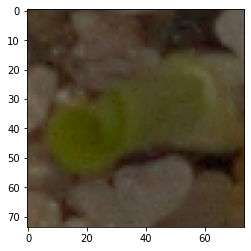

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/1b1ab91eb.png


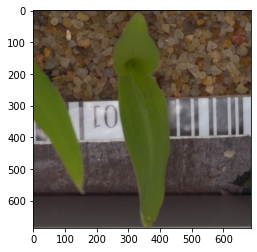

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/030e7f9ef.png


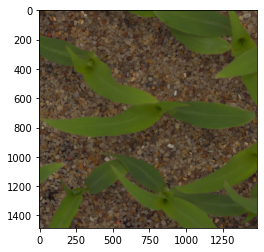

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/18a235096.png


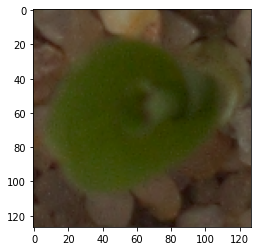

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/084d21b80.png


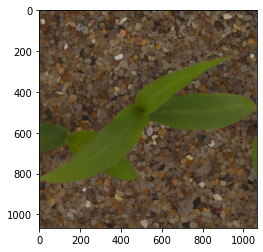

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2d8376136.png


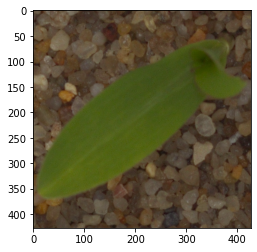

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/31d92d77d.png


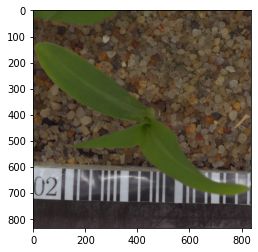

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/362eee504.png


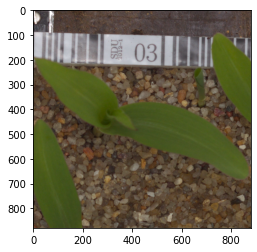

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3a6d4d007.png


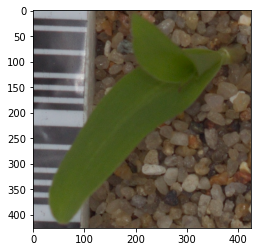

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3ad5d809c.png


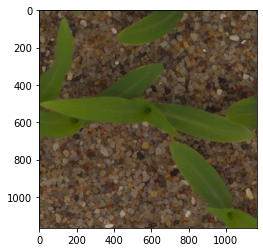

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3b6bc2e4c.png


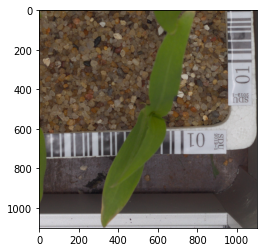

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/21acedc9b.png


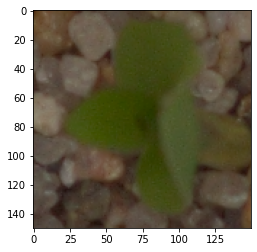

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/34c035273.png


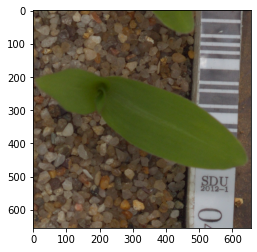

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2187ec5fa.png


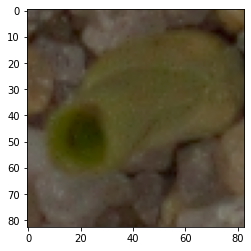

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3ac5a3def.png


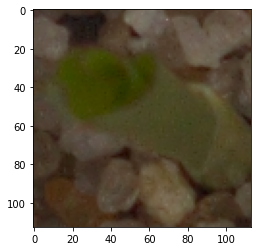

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/27a1dbcdc.png


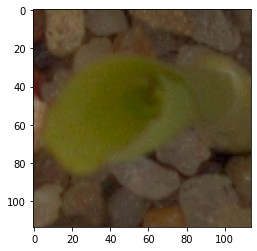

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/365ff4533.png


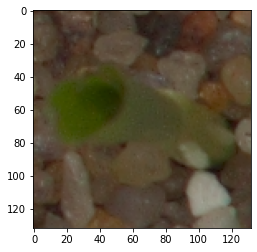

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2bc5905e2.png


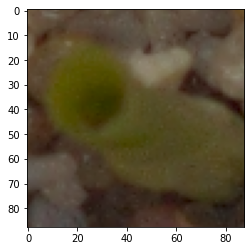

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/30d126c24.png


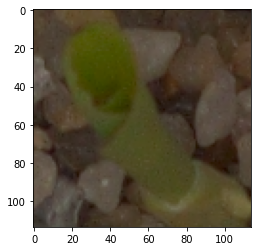

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/23775190c.png


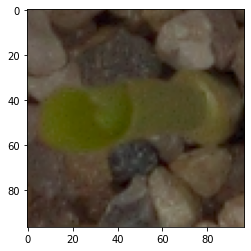

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/270e121c0.png


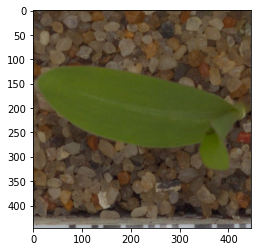

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/30f76315b.png


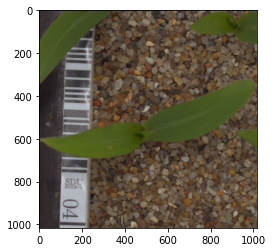

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/23a60f63f.png


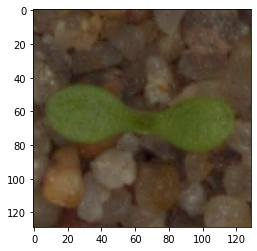

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2b968a9e0.png


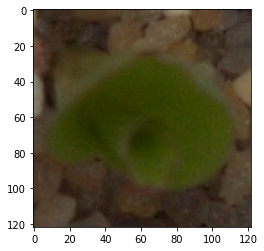

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/1d8e6686f.png


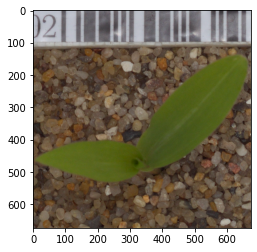

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/269a34bb9.png


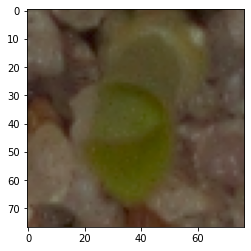

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3213aec10.png


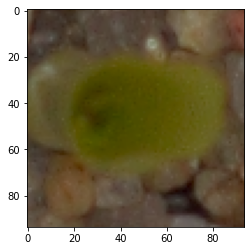

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/280c7b4d2.png


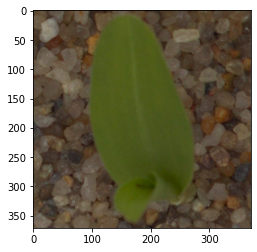

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2b7549816.png


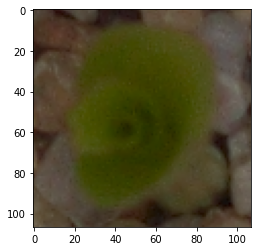

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/266211c3c.png


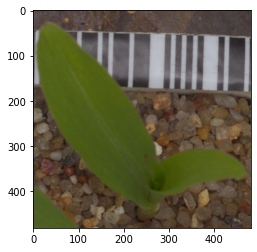

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/37156c661.png


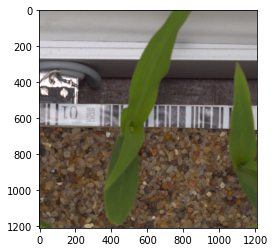

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/388317d6c.png


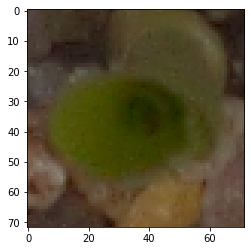

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2d9adb800.png


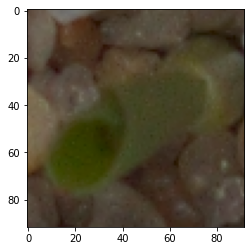

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/2e08d8597.png


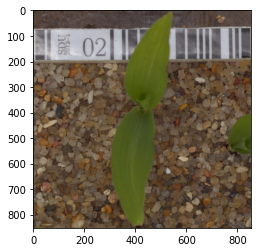

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/25c87a3cc.png


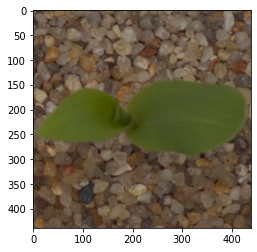

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/44a9a599d.png


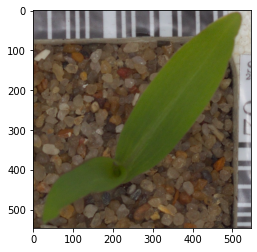

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4ae8bc1c6.png


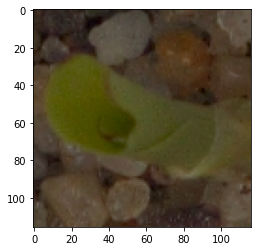

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3cb4f2c65.png


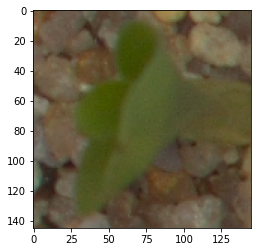

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/49e58b605.png


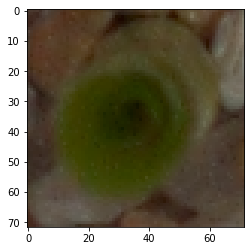

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5251d7bbf.png


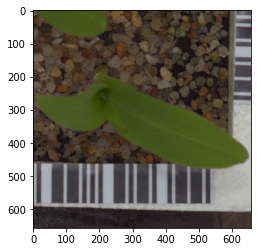

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4b825327e.png


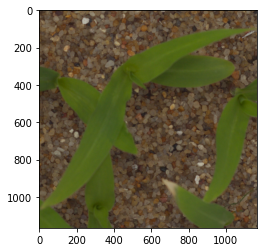

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4f6b0dc39.png


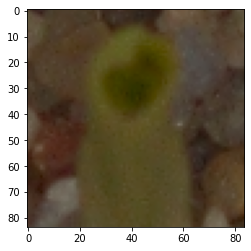

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4e04b01b7.png


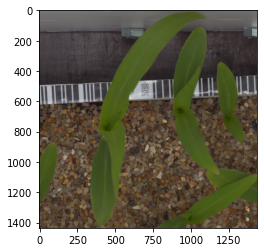

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/50c80a5e4.png


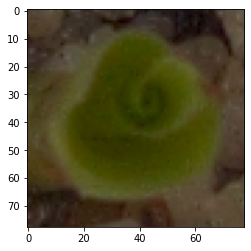

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/489da47a5.png


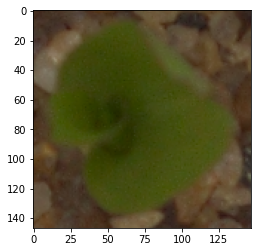

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4b5aa18ad.png


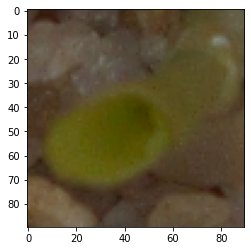

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5112e0b90.png


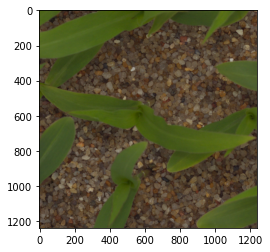

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3ef465952.png


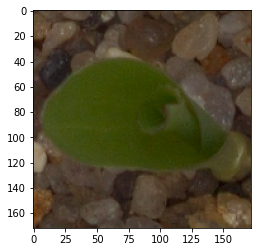

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5150527da.png


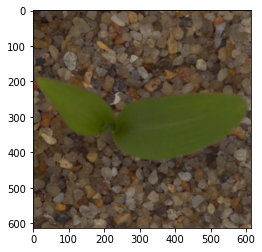

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4ef677ce4.png


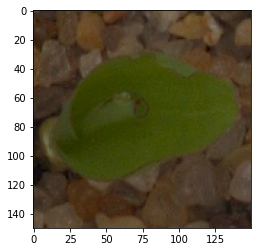

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/44d562432.png


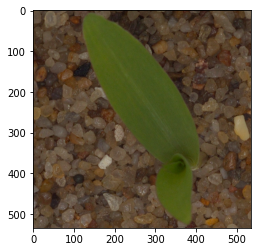

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/3cf92e356.png


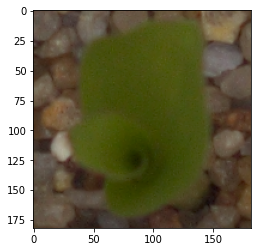

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4ba437481.png


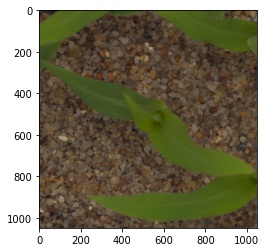

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/4a1929689.png


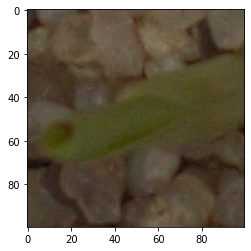

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/642e055ee.png


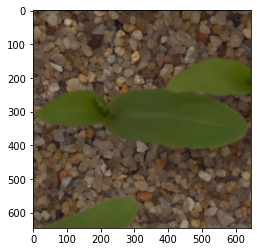

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/55083690a.png


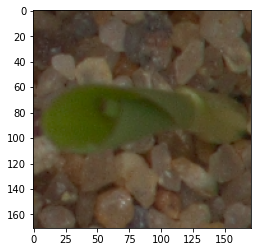

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/59f972ef4.png


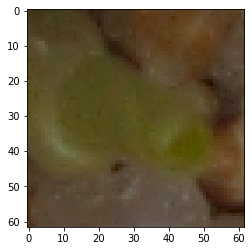

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5622305e8.png


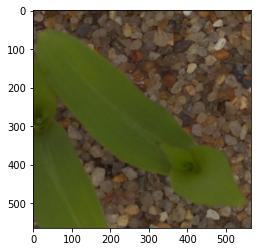

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5b94fab70.png


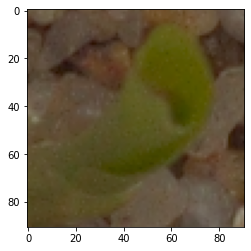

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5fdb1dccf.png


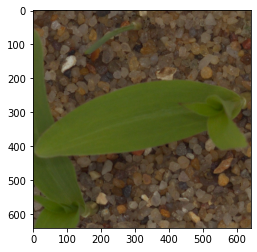

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5363a9f84.png


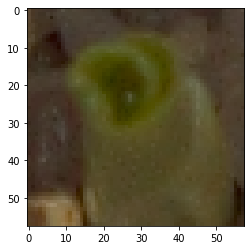

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5d6e3b183.png


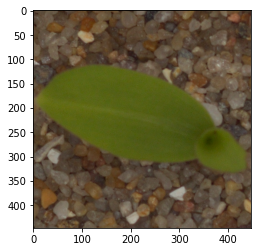

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5d641d627.png


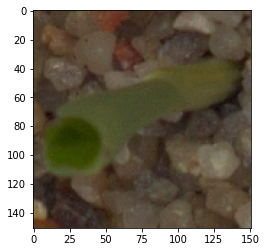

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5c7abc049.png


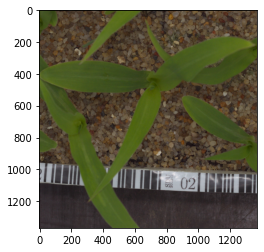

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/606d5c83f.png


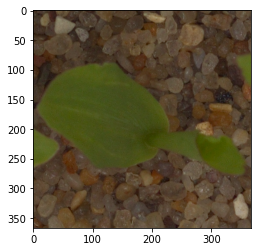

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/6219b36db.png


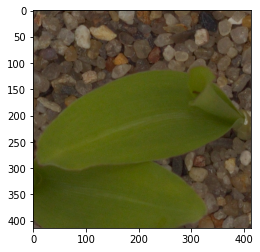

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5c826024a.png


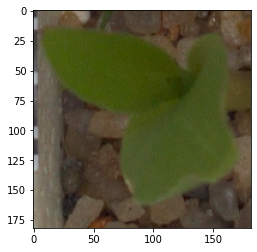

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/648ddc558.png


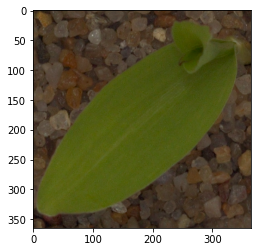

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5675e608c.png


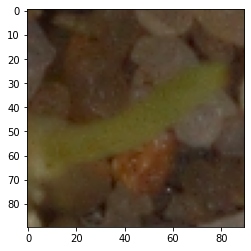

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/62a1614a2.png


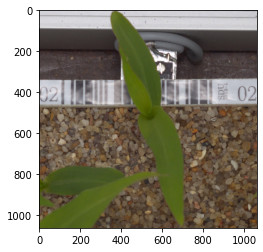

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5453bff0b.png


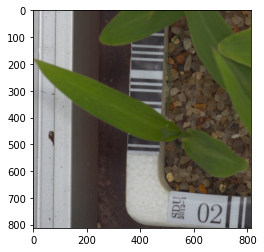

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5885bb41b.png


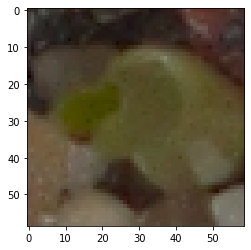

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/61c7d55b0.png


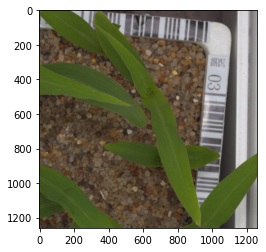

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5a7d10c3d.png


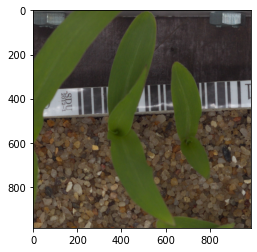

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/6495c3f49.png


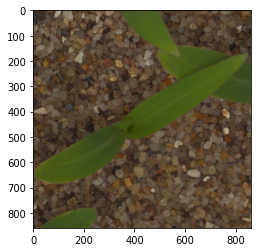

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/5dfa39111.png


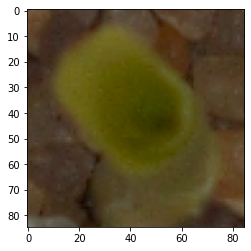

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/7389aea72.png


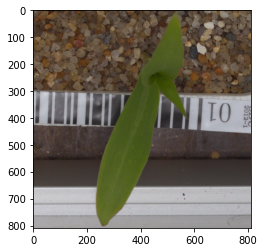

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/65ba0f497.png


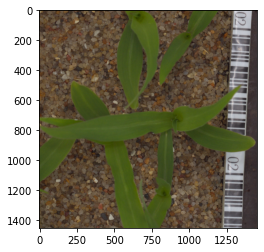

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/69f06fcbc.png


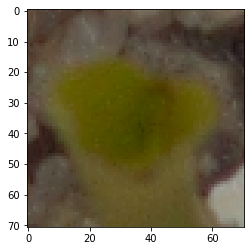

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/6e9ff31e7.png


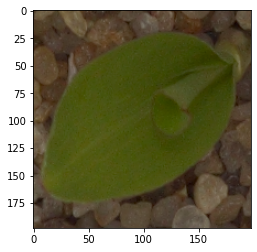

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/64a6f6f65.png


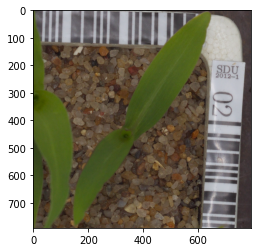

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/7446f241c.png


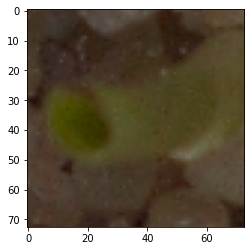

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/66e90b455.png


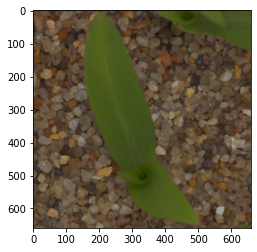

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/7736aedff.png


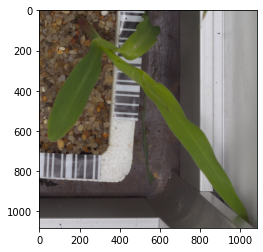

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/749646c56.png


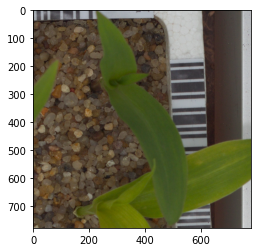

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/649b7af36.png


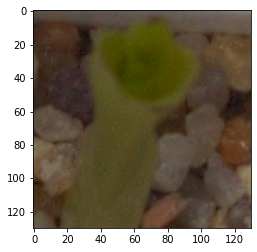

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/66a87d834.png


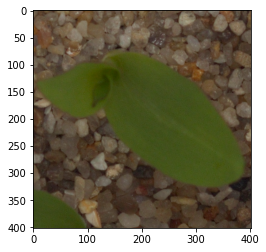

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/6d54412c3.png


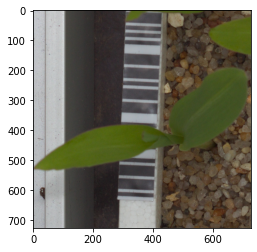

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/67c3663a8.png


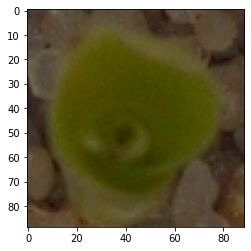

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/65b4ebc41.png


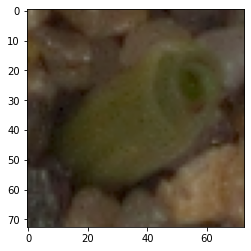

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/665b921f2.png


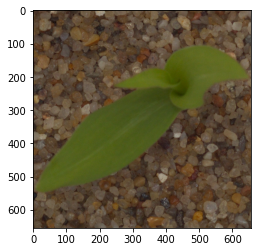

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/70b85477d.png


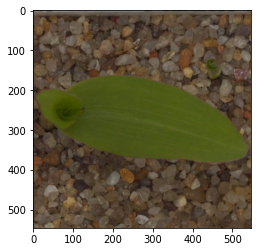

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8a257f6f6.png


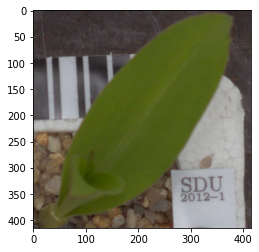

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8bfe6860d.png


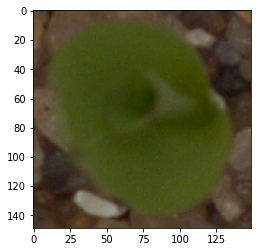

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/814e74c21.png


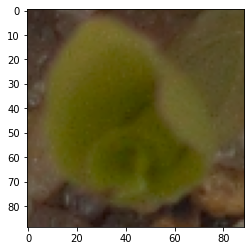

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/77a5a4b51.png


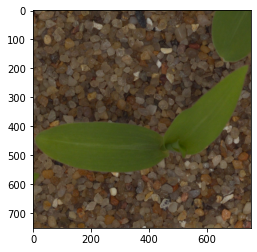

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8439a7dad.png


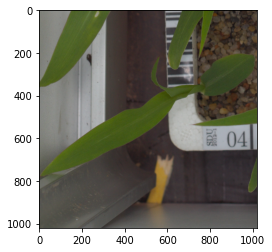

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8c70f6c91.png


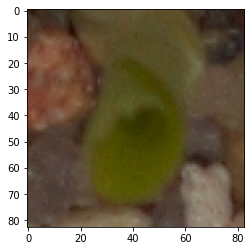

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8c6fba454.png


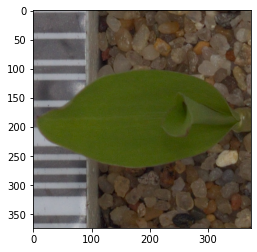

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/80fa83273.png


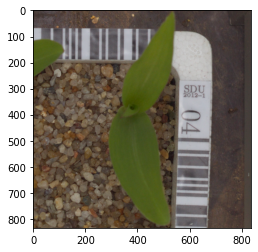

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/85ae913c3.png


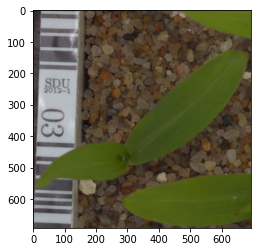

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/87a3254c9.png


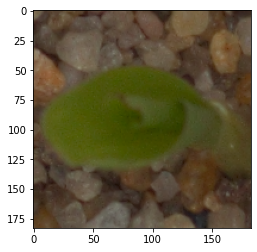

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8c71f9b84.png


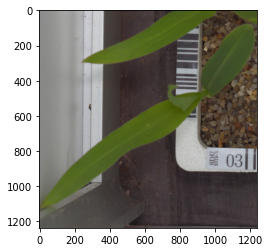

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/798852825.png


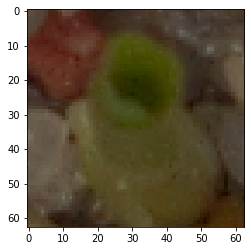

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/84ba8107f.png


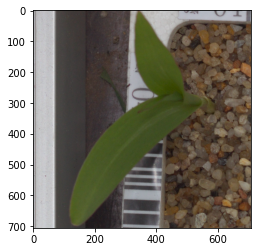

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/87bbc41eb.png


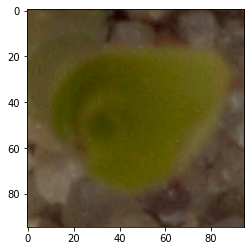

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/822d1163b.png


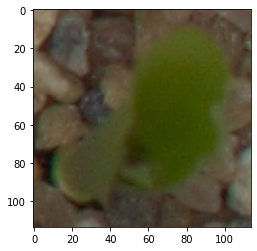

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/7f23a2f31.png


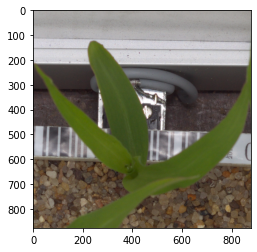

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/85c25b5a2.png


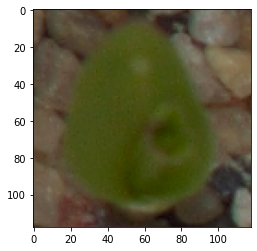

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8caddf555.png


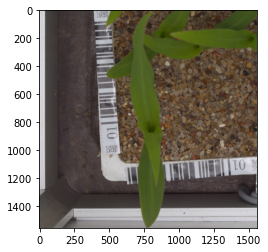

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/907817b91.png


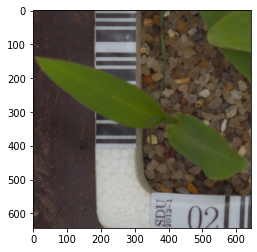

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/905f9f385.png


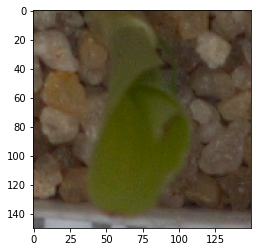

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/97da6a579.png


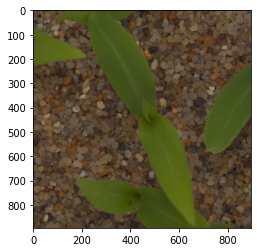

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a1d7080b1.png


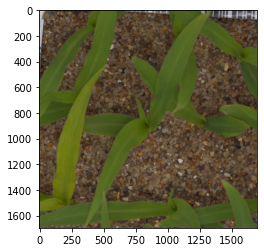

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/919e154c2.png


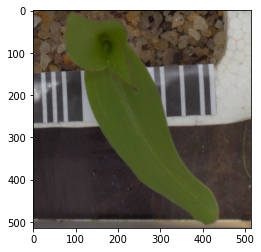

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/9977e50bc.png


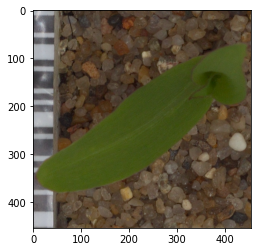

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/91a9d5b9d.png


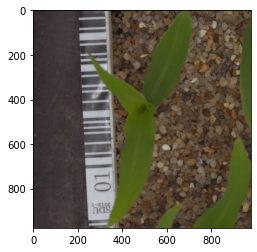

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8cd93b279.png


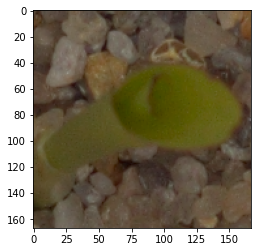

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/988113525.png


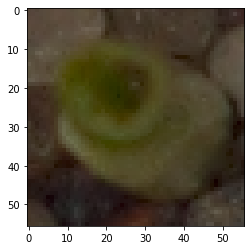

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/9fc63a912.png


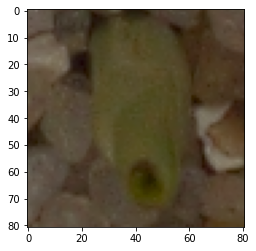

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/982130e94.png


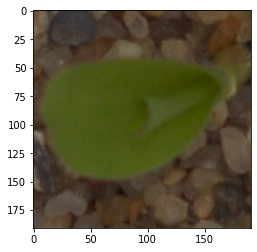

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/8d2004e7a.png


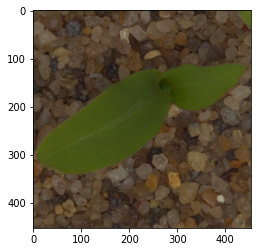

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/9d3514473.png


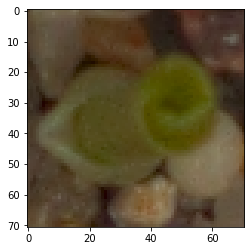

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/9d588ace5.png


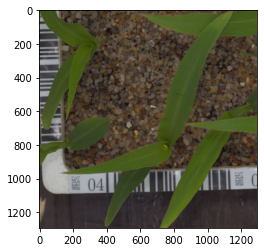

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/96d476790.png


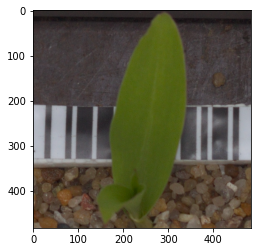

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/92c06eaca.png


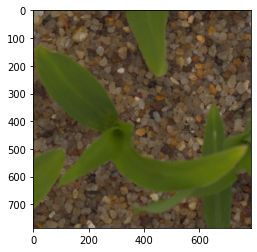

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/9d1e59e00.png


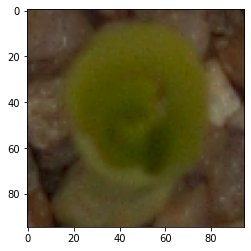

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b0df48778.png


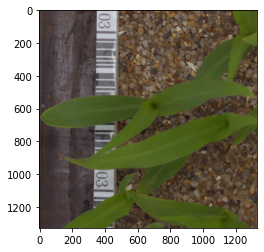

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a37e7b7db.png


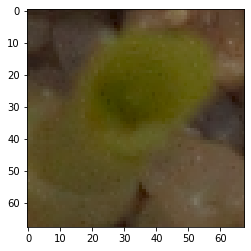

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a53a61390.png


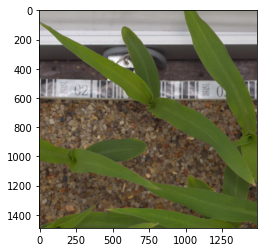

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a5c2eec2d.png


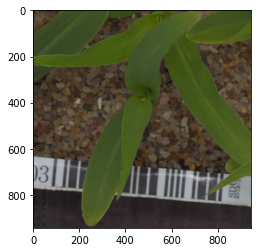

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/af014d45e.png


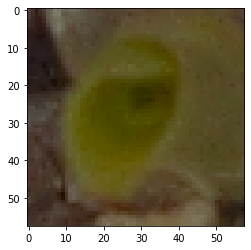

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a4e71c6c3.png


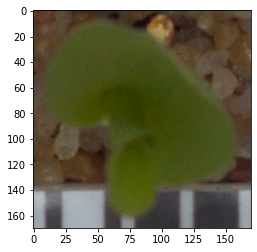

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a76555ad2.png


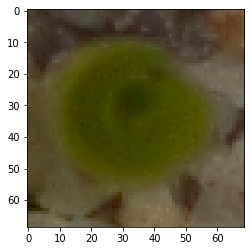

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/ac3de5925.png


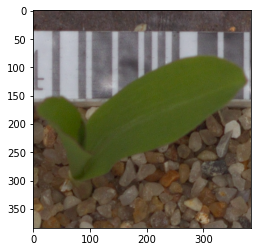

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a47bdd663.png


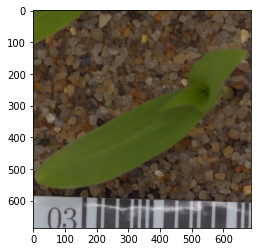

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a353bdbd9.png


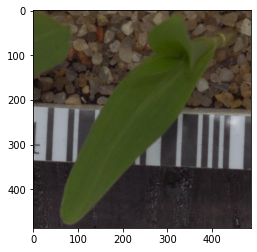

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a6e44df4f.png


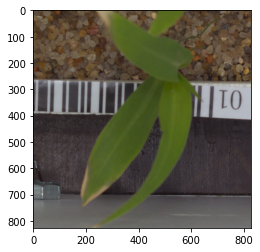

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b273efc22.png


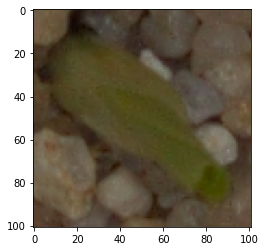

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/a30702538.png


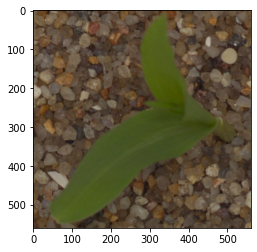

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/abadd72ab.png


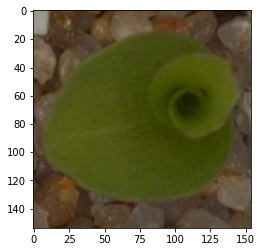

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b496ed692.png


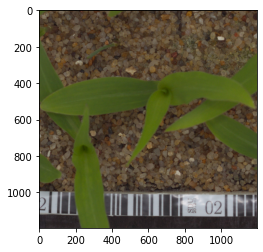

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b8b2658d9.png


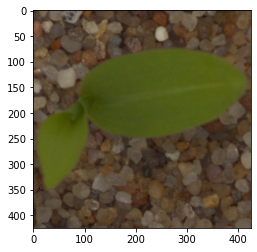

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b72a19852.png


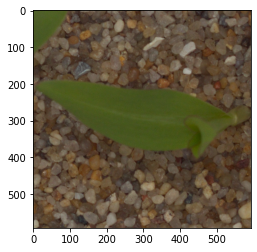

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/bede27c87.png


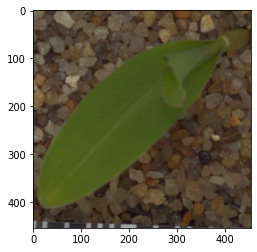

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c6dc512e9.png


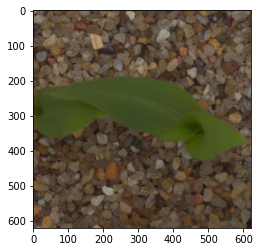

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c6fabfb59.png


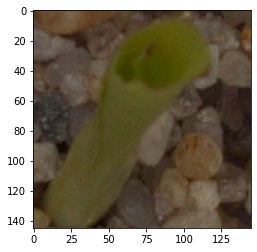

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c621da984.png


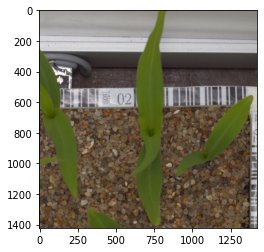

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/bb9f796ce.png


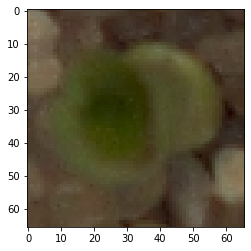

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b9ffd31a7.png


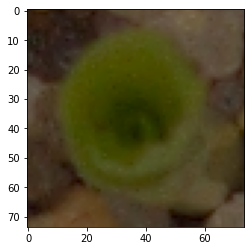

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c05a8d7e1.png


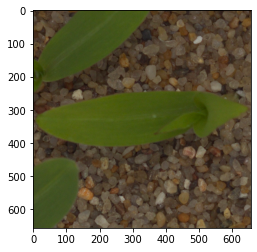

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c9b1820d0.png


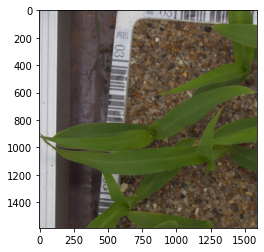

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/bf22827fb.png


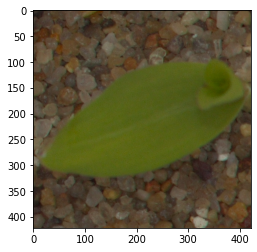

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c5bcc4cb3.png


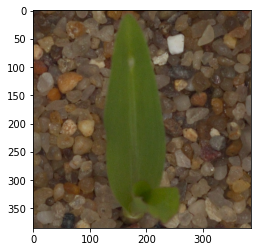

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/b62a6a471.png


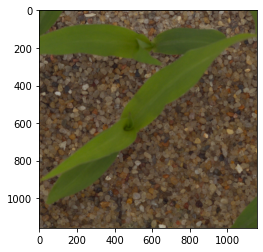

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/c08835318.png


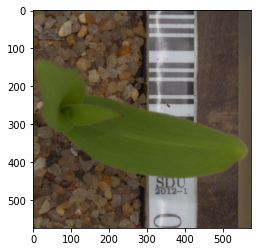

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f3b0496dd.png


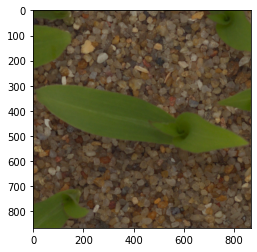

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e66d87ad7.png


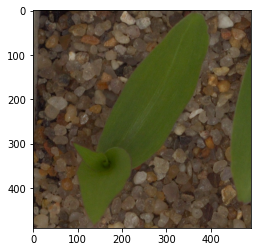

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f5231714b.png


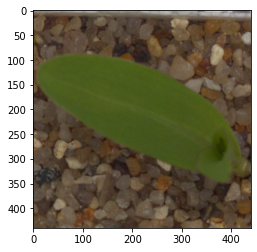

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/dc7a7bdeb.png


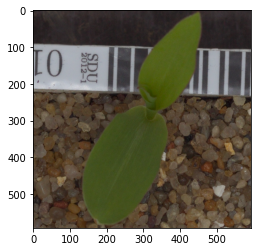

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f2c22a1bf.png


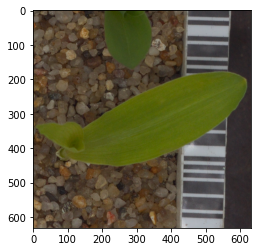

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/cf7b09a39.png


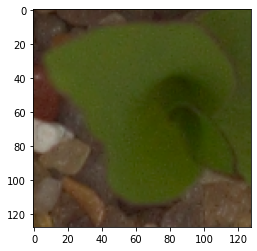

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/d99129a77.png


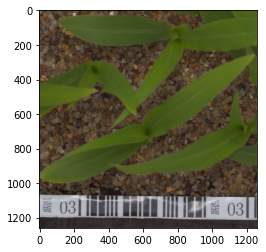

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/edd80f8a8.png


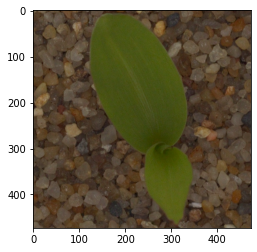

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e6d8ba41c.png


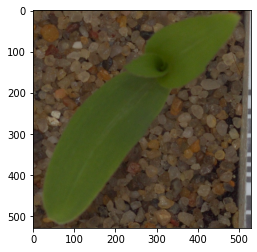

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f34429b11.png


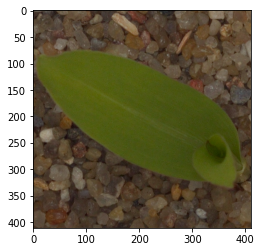

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e17f5daf0.png


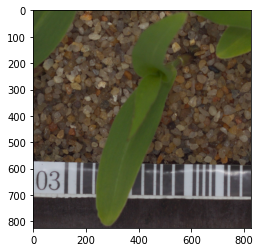

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/eefba9376.png


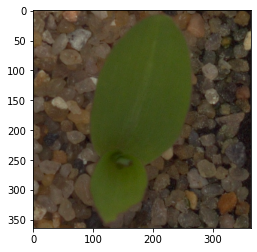

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e43323e28.png


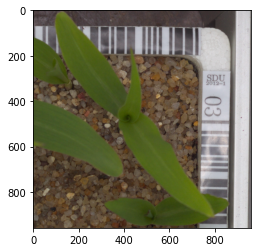

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/cccbcc365.png


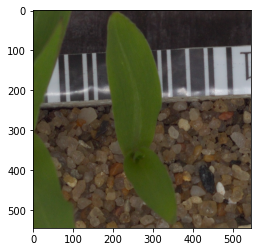

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/cd2b68ba2.png


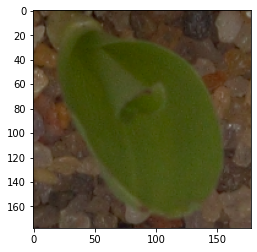

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/ce76cb1e5.png


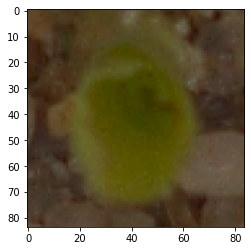

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f60369038.png


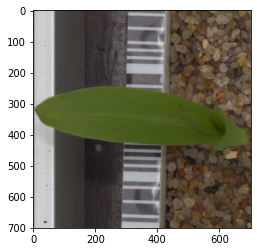

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e45f92ca7.png


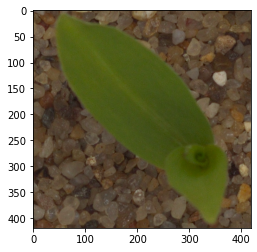

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/d3963a326.png


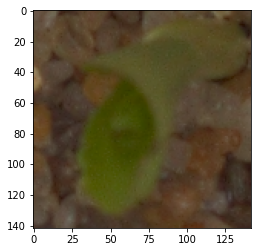

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/cc3674663.png


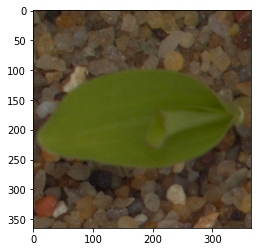

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e364ace75.png


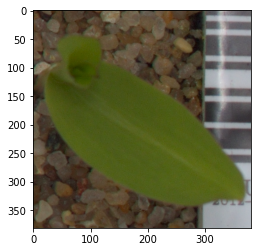

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/d3cf21397.png


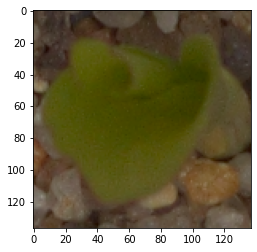

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f5e10e5ec.png


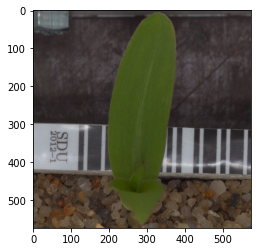

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/eba973942.png


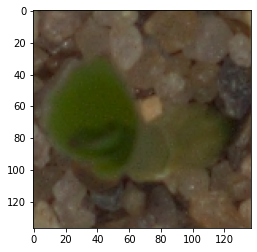

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f135a739f.png


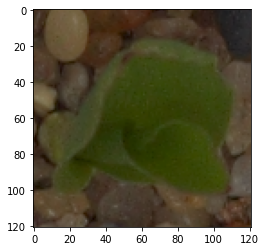

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/d8ae9a82b.png


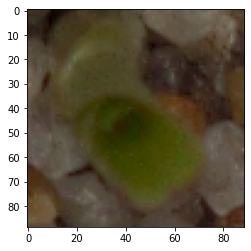

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/cdcb0f735.png


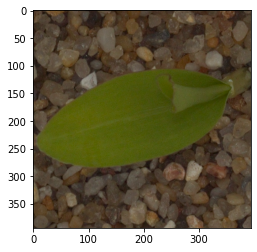

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/e30accd2f.png


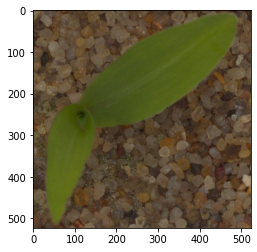

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f4dd93492.png


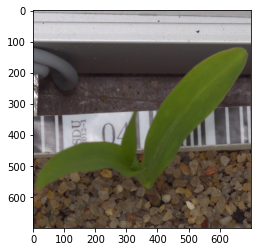

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f30971a76.png


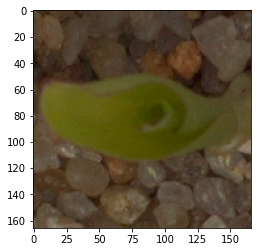

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/ff4b55219.png


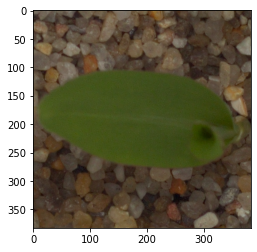

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fb6bcaf52.png


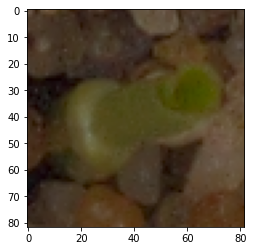

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fbd09f3a5.png


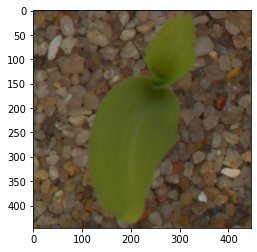

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fb6328acb.png


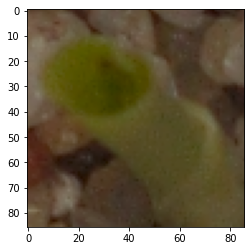

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fbed08a0e.png


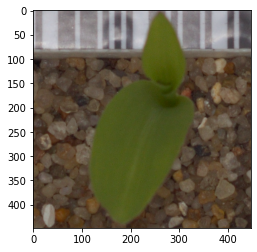

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f98add892.png


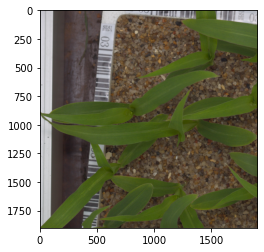

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fdebe4158.png


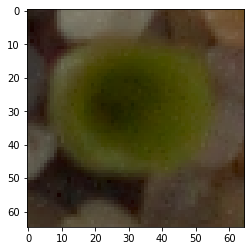

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fdde1498f.png


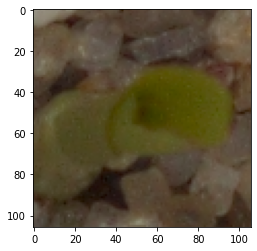

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fc68c0525.png


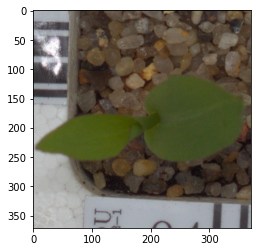

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fd1ef540c.png


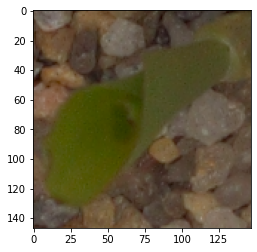

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/fc02b8466.png


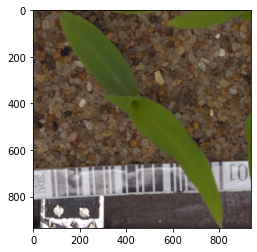

/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize/f9ceba607.png


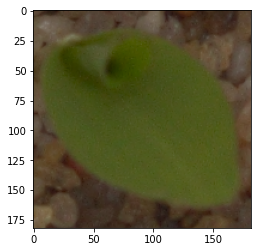

In [ ]:
print('Printing all images in Maize Folder')
for image1 in os.listdir('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize'):
  pathprint=os.path.join('/content/drive/MyDrive/AIML/ComputerVision/Part_1_Input/train/Maize', image1)
  print(pathprint)
  img= load_img(pathprint)
  plt.imshow(img)
  plt.show()

**Label we predicted is matched with the True Label** ** Predicted Label -7 (Maize)**

# Part 2 :::: Explain in depth why CNN out performs neural networks which in turn out perform supervised learning models when it comes to image classification. Use the markdown option in Jupiter for your answer.

Below are the few points that makes the CNN out performs Neural Networks and Supervised Learning



*   **Decision Boundary**  - Machine Learning algorithms is not capable of learning its parameters . Ex: If we take the logistic Regression algorithm it can learns only on the Linear decision Boundary 
*   **Feature Extraction**  - We can Automate Process of Feature Engineering in this DEep Learning Models

So Deep Learning out performs Supervised Learning


Reasons why CNN outperforms Neural Networks:


*   In ANN we used to convert 2D array into 1D before passing as input into network. But in CNN **we can have N channels**
*   As in the ANN we have this Vanishing /exploding Gradient challenges we can resolve handle this issue in CNN (RESNET deals this issue with skip connections)



